<a href="https://colab.research.google.com/github/Ananya-1233/CCTV-object-detection/blob/main/CCTV_Object_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [5]:
#Commands to access the datasets on Kaggle
#Make a seperate directory for kaggle and give access for Kaggle to export datasets
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

In [6]:
!kaggle datasets download -d insaneshadowzaman/highway-cctv-footage-images

 30% 9.00M/30.3M [00:00<00:00, 25.6MB/s]
100% 30.3M/30.3M [00:00<00:00, 77.8MB/s]


In [7]:
!kaggle datasets download -d valentynsichkar/yolo-coco-data

 97% 213M/220M [00:01<00:00, 133MB/s] 
100% 220M/220M [00:02<00:00, 113MB/s]


In [8]:
#Unzipping the zipfile of images
import zipfile

data_zip = zipfile.ZipFile('/content/yolo-coco-data.zip')
data_zip.extractall()
data_zip.close()

In [9]:
#Unzipping the zipfile of images
import zipfile

data_zip = zipfile.ZipFile('/content/highway-cctv-footage-images.zip')
data_zip.extractall()
data_zip.close()

In [10]:
import pandas as pd
import numpy as np
import os
import cv2
import time
import matplotlib.pyplot as plt
from tqdm import tqdm
import tensorflow as tf
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from matplotlib import animation,rc
rc('animation',html='jshtml')

In [11]:
import tensorflow as tf
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
except:
    strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

Number of replicas: 1


In [12]:
paths = []
import os
for dirname,_,filenames in os.walk('/content/input_images'):
  for filename in filenames:
    paths += [os.path.join(dirname, filename)]
paths[0:5]

['/content/input_images/img_71.jpg',
 '/content/input_images/img_29.jpg',
 '/content/input_images/img_2.jpg',
 '/content/input_images/img_80.jpg',
 '/content/input_images/img_93.jpg']

In [13]:
len(paths)

98

In [14]:
order = []
for item in paths:
  order += [int(item[:-4].split('_')[-1])]
paths = pd.DataFrame(paths)
paths[1] = order
paths.columns = ['path','int']
paths2 = paths['path'].tolist()
paths2[0:5]

['/content/input_images/img_71.jpg',
 '/content/input_images/img_29.jpg',
 '/content/input_images/img_2.jpg',
 '/content/input_images/img_80.jpg',
 '/content/input_images/img_93.jpg']

In [15]:
labels = open('/content/coco.names').read().strip().split('\n')
print(len(labels))

80


In [16]:
weights_path = '/content/yolov3.weights'
config_path = '/content/yolov3.cfg'
min_prob = 0.5
threshold = 0.3

In [24]:
network = cv2.dnn.readNetFromDarknet(config_path, weights_path)
layers_names_all = network.getLayerNames()
layers_names_output = [layers_names_all[i-1] for i in network.getUnconnectedOutLayers()]

In [26]:
layers_names_output

['yolo_82', 'yolo_94', 'yolo_106']

In [31]:
images0 = []
for item in paths2:
  images0 += [cv2.imread(item)]

In [33]:
images1=[]

for image_input in tqdm(images0):

    blob = cv2.dnn.blobFromImage(image_input, 1/255.0, (416,416), swapRB=True, crop=False)
    blob_to_show = blob[0,:,:,:].transpose(1,2,0)
    network.setInput(blob)
    output_from_network = network.forward(layers_names_output)
    np.random.seed(42)
    colours = np.random.randint(0, 255, size=(len(labels), 3), dtype='uint8')

    bounding_boxes = []
    confidences = []
    class_numbers = []
    h,w = image_input.shape[:2]

    for result in output_from_network:
        for detection in result:
            scores = detection[5:]
            class_current = np.argmax(scores)
            confidence_current = scores[class_current]
            if confidence_current > min_prob:
                box_current = detection[0:4] * np.array([w, h, w, h])
                x_center, y_center, box_width, box_height = box_current.astype('int')
                x_min = int(x_center-(box_width/2))
                y_min = int(y_center-(box_height/2))
                bounding_boxes.append([x_min, y_min, int(box_width), int(box_height)])
                confidences.append(float(confidence_current))
                class_numbers.append(class_current)

    results = cv2.dnn.NMSBoxes(bounding_boxes, confidences, min_prob, threshold)

    if len(results) > 0:
        for i in results.flatten():
            x_min, y_min = bounding_boxes[i][0], bounding_boxes[i][1]
            box_width, box_height = bounding_boxes[i][2], bounding_boxes[i][3]
            colour_box_current = [int(j) for j in colours[class_numbers[i]]]
            cv2.rectangle(image_input, (x_min, y_min), (x_min + box_width, y_min + box_height),
                          colour_box_current, 5)
            text_box_current = '{}: {:.4f}'.format(labels[int(class_numbers[i])], confidences[i])
            cv2.putText(image_input, text_box_current, (x_min, y_min - 7), cv2.FONT_HERSHEY_SIMPLEX,
                        1.5, colour_box_current, 5)
        images1+=[image_input]

100%|██████████| 98/98 [01:34<00:00,  1.03it/s]


In [34]:
def create_animation(ims):
    fig=plt.figure(figsize=(15,10))
    plt.axis('off')
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))

    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000//4)

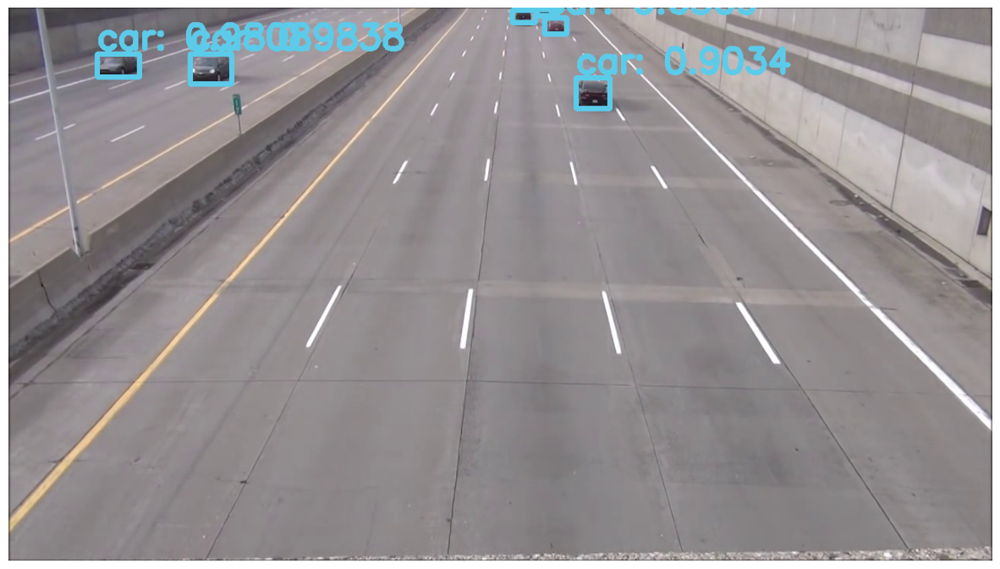

In [35]:
create_animation(images1)